In [2]:
from PIL import Image, ImageDraw
import os
import numpy as np
import torch
import torch.utils.data
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

In [3]:
class PennFudanDataset(torch.utils.data.Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        # load all image files, sorting them to
        # ensure that they are aligned
        self.imgs = list(sorted(os.listdir(os.path.join(root, "PNGImages"))))
        self.masks = list(sorted(os.listdir(os.path.join(root, "PedMasks"))))
 
    def __getitem__(self, idx):
        # load images ad masks
        img_path = os.path.join(self.root, "PNGImages", self.imgs[idx])
        mask_path = os.path.join(self.root, "PedMasks", self.masks[idx])
        img = Image.open(img_path).convert("RGB")
        # note that we haven't converted the mask to RGB,
        # because each color corresponds to a different instance
        # with 0 being background
        mask = Image.open(mask_path)
 
        mask = np.array(mask)
        # instances are encoded as different colors
        obj_ids = np.unique(mask)
        # first id is the background, so remove it
        obj_ids = obj_ids[1:]
 
        # split the color-encoded mask into a set
        # of binary masks
        masks = mask == obj_ids[:, None, None]
 
        # get bounding box coordinates for each mask
        num_objs = len(obj_ids)
        boxes = []
        for i in range(num_objs):
            pos = np.where(masks[i])
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])
 
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # there is only one class
        labels = torch.ones((num_objs,), dtype=torch.int64)
        masks = torch.as_tensor(masks, dtype=torch.uint8)
 
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
 
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["masks"] = masks
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd
 
        if self.transforms is not None:
            img, target = self.transforms(img, target)
 
        return img, target
 
    def __len__(self):
        return len(self.imgs)

In [4]:
def get_instance_segmentation_model(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
 
    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
 
    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                       hidden_layer,
                                                       num_classes)
 
    return model

In [5]:
from engine import train_one_epoch, evaluate
import utils
import transforms as T
 
 
def get_transform(train):
    transforms = []
    # converts the image, a PIL image, into a PyTorch Tensor
    transforms.append(T.ToTensor())
    if train:
        # during training, randomly flip the training images
        # and ground-truth for data augmentation
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

In [6]:
# use our dataset and defined transformations
dataset = PennFudanDataset('PennFudanPed', get_transform(train=True))
dataset_test = PennFudanDataset('PennFudanPed', get_transform(train=False))
 
# split the dataset in train and test set
torch.manual_seed(1)
indices = torch.randperm(len(dataset)).tolist()
dataset = torch.utils.data.Subset(dataset, indices[:-50])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-50:])
 
# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=2, shuffle=False, 
    collate_fn=utils.collate_fn)
 
data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, 
    collate_fn=utils.collate_fn)

In [7]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
 
# our dataset has two classes only - background and person
num_classes = 2
 
# get the model using our helper function
model = get_instance_segmentation_model(num_classes)
# move model to the right device
model.to(device)
 
# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)
 
# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)

C:\Users\young\anaconda3_1\envs\youngs\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
C:\Users\young\anaconda3_1\envs\youngs\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [8]:
# let's train it for 10 epochs
num_epochs = 10
 
for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, data_loader_test, device=device)

Epoch: [0]  [ 0/60]  eta: 0:04:59  lr: 0.000090  loss: 2.8694 (2.8694)  loss_classifier: 0.7950 (0.7950)  loss_box_reg: 0.3199 (0.3199)  loss_mask: 1.7315 (1.7315)  loss_objectness: 0.0147 (0.0147)  loss_rpn_box_reg: 0.0083 (0.0083)  time: 4.9952  data: 0.0549  max mem: 2133
Epoch: [0]  [10/60]  eta: 0:00:54  lr: 0.000936  loss: 1.3046 (1.7016)  loss_classifier: 0.4886 (0.4829)  loss_box_reg: 0.2749 (0.3047)  loss_mask: 0.6724 (0.8931)  loss_objectness: 0.0138 (0.0164)  loss_rpn_box_reg: 0.0048 (0.0046)  time: 1.0895  data: 0.0325  max mem: 3592
Epoch: [0]  [20/60]  eta: 0:00:34  lr: 0.001783  loss: 0.9625 (1.2077)  loss_classifier: 0.1925 (0.3271)  loss_box_reg: 0.2371 (0.2697)  loss_mask: 0.3278 (0.5912)  loss_objectness: 0.0115 (0.0144)  loss_rpn_box_reg: 0.0042 (0.0054)  time: 0.6593  data: 0.0321  max mem: 3592
Epoch: [0]  [30/60]  eta: 0:00:24  lr: 0.002629  loss: 0.5308 (0.9911)  loss_classifier: 0.0811 (0.2515)  loss_box_reg: 0.1968 (0.2617)  loss_mask: 0.2033 (0.4586)  loss_ob

Epoch: [2]  [ 0/60]  eta: 0:00:37  lr: 0.005000  loss: 0.2915 (0.2915)  loss_classifier: 0.0421 (0.0421)  loss_box_reg: 0.1132 (0.1132)  loss_mask: 0.1282 (0.1282)  loss_objectness: 0.0005 (0.0005)  loss_rpn_box_reg: 0.0076 (0.0076)  time: 0.6233  data: 0.0249  max mem: 3592
Epoch: [2]  [10/60]  eta: 0:00:33  lr: 0.005000  loss: 0.2216 (0.2255)  loss_classifier: 0.0327 (0.0313)  loss_box_reg: 0.0707 (0.0706)  loss_mask: 0.1194 (0.1192)  loss_objectness: 0.0002 (0.0004)  loss_rpn_box_reg: 0.0036 (0.0040)  time: 0.6630  data: 0.0264  max mem: 3592
Epoch: [2]  [20/60]  eta: 0:00:25  lr: 0.005000  loss: 0.2197 (0.2242)  loss_classifier: 0.0273 (0.0299)  loss_box_reg: 0.0540 (0.0658)  loss_mask: 0.1194 (0.1240)  loss_objectness: 0.0005 (0.0007)  loss_rpn_box_reg: 0.0036 (0.0038)  time: 0.6488  data: 0.0279  max mem: 3592
Epoch: [2]  [30/60]  eta: 0:00:19  lr: 0.005000  loss: 0.2160 (0.2243)  loss_classifier: 0.0273 (0.0292)  loss_box_reg: 0.0540 (0.0665)  loss_mask: 0.1149 (0.1235)  loss_ob

Epoch: [4]  [ 0/60]  eta: 0:00:39  lr: 0.000500  loss: 0.2622 (0.2622)  loss_classifier: 0.0503 (0.0503)  loss_box_reg: 0.0842 (0.0842)  loss_mask: 0.1224 (0.1224)  loss_objectness: 0.0003 (0.0003)  loss_rpn_box_reg: 0.0052 (0.0052)  time: 0.6662  data: 0.0219  max mem: 3592
Epoch: [4]  [10/60]  eta: 0:00:34  lr: 0.000500  loss: 0.1821 (0.1748)  loss_classifier: 0.0261 (0.0254)  loss_box_reg: 0.0363 (0.0398)  loss_mask: 0.1014 (0.1063)  loss_objectness: 0.0003 (0.0004)  loss_rpn_box_reg: 0.0033 (0.0030)  time: 0.6823  data: 0.0270  max mem: 3592
Epoch: [4]  [20/60]  eta: 0:00:27  lr: 0.000500  loss: 0.1623 (0.1772)  loss_classifier: 0.0205 (0.0255)  loss_box_reg: 0.0298 (0.0393)  loss_mask: 0.1005 (0.1088)  loss_objectness: 0.0002 (0.0005)  loss_rpn_box_reg: 0.0024 (0.0030)  time: 0.6803  data: 0.0278  max mem: 3592
Epoch: [4]  [30/60]  eta: 0:00:20  lr: 0.000500  loss: 0.1626 (0.1761)  loss_classifier: 0.0208 (0.0247)  loss_box_reg: 0.0296 (0.0379)  loss_mask: 0.1043 (0.1097)  loss_ob

Epoch: [6]  [ 0/60]  eta: 0:00:37  lr: 0.000050  loss: 0.2632 (0.2632)  loss_classifier: 0.0367 (0.0367)  loss_box_reg: 0.0926 (0.0926)  loss_mask: 0.1282 (0.1282)  loss_objectness: 0.0010 (0.0010)  loss_rpn_box_reg: 0.0047 (0.0047)  time: 0.6283  data: 0.0219  max mem: 3592
Epoch: [6]  [10/60]  eta: 0:00:34  lr: 0.000050  loss: 0.1594 (0.1681)  loss_classifier: 0.0226 (0.0236)  loss_box_reg: 0.0323 (0.0365)  loss_mask: 0.0991 (0.1047)  loss_objectness: 0.0004 (0.0007)  loss_rpn_box_reg: 0.0026 (0.0026)  time: 0.6935  data: 0.0267  max mem: 3592
Epoch: [6]  [20/60]  eta: 0:00:27  lr: 0.000050  loss: 0.1535 (0.1713)  loss_classifier: 0.0191 (0.0237)  loss_box_reg: 0.0249 (0.0362)  loss_mask: 0.0991 (0.1083)  loss_objectness: 0.0003 (0.0005)  loss_rpn_box_reg: 0.0026 (0.0026)  time: 0.6895  data: 0.0288  max mem: 3592
Epoch: [6]  [30/60]  eta: 0:00:20  lr: 0.000050  loss: 0.1550 (0.1691)  loss_classifier: 0.0198 (0.0231)  loss_box_reg: 0.0263 (0.0343)  loss_mask: 0.1015 (0.1085)  loss_ob

Epoch: [8]  [ 0/60]  eta: 0:00:37  lr: 0.000050  loss: 0.2017 (0.2017)  loss_classifier: 0.0345 (0.0345)  loss_box_reg: 0.0485 (0.0485)  loss_mask: 0.1147 (0.1147)  loss_objectness: 0.0002 (0.0002)  loss_rpn_box_reg: 0.0038 (0.0038)  time: 0.6243  data: 0.0239  max mem: 3592
Epoch: [8]  [10/60]  eta: 0:00:40  lr: 0.000050  loss: 0.1643 (0.1600)  loss_classifier: 0.0224 (0.0223)  loss_box_reg: 0.0313 (0.0326)  loss_mask: 0.0973 (0.1024)  loss_objectness: 0.0003 (0.0004)  loss_rpn_box_reg: 0.0023 (0.0023)  time: 0.8000  data: 0.0270  max mem: 3592
Epoch: [8]  [20/60]  eta: 0:00:29  lr: 0.000050  loss: 0.1564 (0.1712)  loss_classifier: 0.0186 (0.0235)  loss_box_reg: 0.0274 (0.0349)  loss_mask: 0.0975 (0.1094)  loss_objectness: 0.0003 (0.0006)  loss_rpn_box_reg: 0.0023 (0.0028)  time: 0.7562  data: 0.0277  max mem: 3592
Epoch: [8]  [30/60]  eta: 0:00:21  lr: 0.000050  loss: 0.1517 (0.1701)  loss_classifier: 0.0189 (0.0230)  loss_box_reg: 0.0252 (0.0341)  loss_mask: 0.1033 (0.1095)  loss_ob

In [16]:
# pick one image from the test set
basic, prediction = [], []
model.eval()
for i in range(len(dataset_test)):
    img, _ = dataset_test[i]
    basic.append(img)
    # put the model in evaluation mode
    with torch.no_grad():
        prediction.append(model([basic[i].to(device)]))
    
    Image.fromarray(basic[i].mul(255).permute(1, 2, 0).byte().numpy())
    Image.fromarray(prediction[i][0]['masks'][0, 0].mul(255).byte().cpu().numpy())


number of detected people: 2


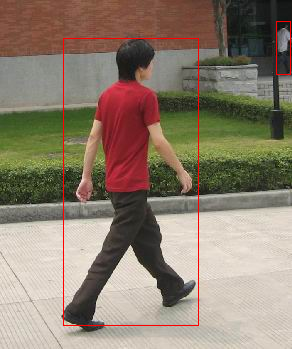

number of detected people: 3


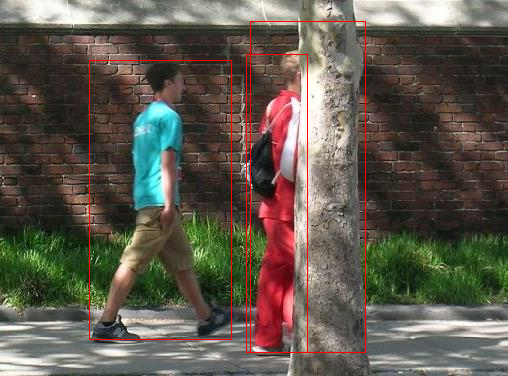

number of detected people: 2


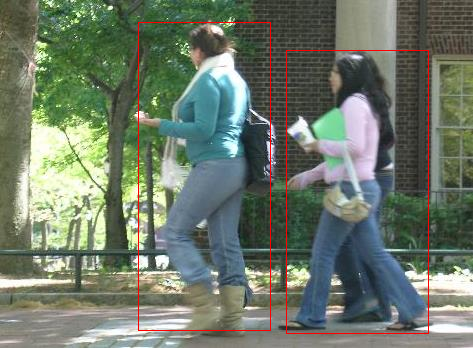

number of detected people: 8


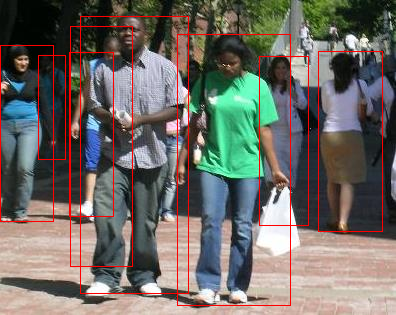

number of detected people: 7


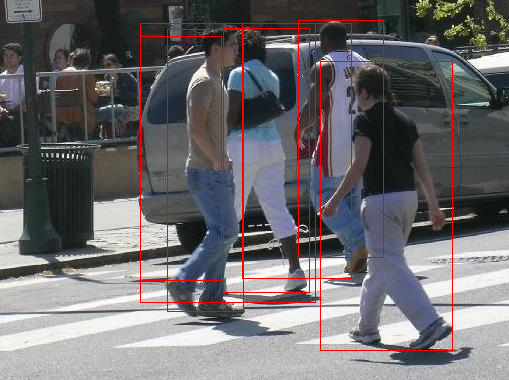

number of detected people: 2


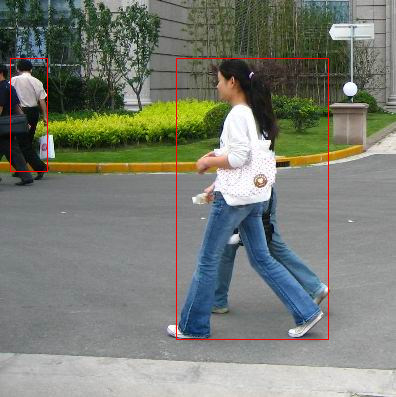

number of detected people: 5


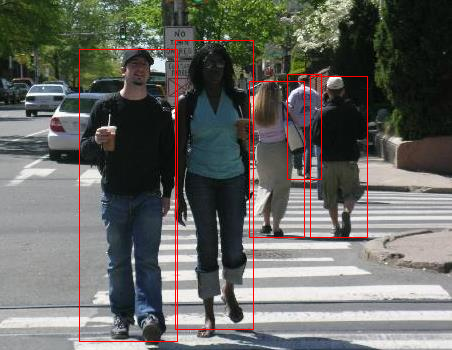

number of detected people: 6


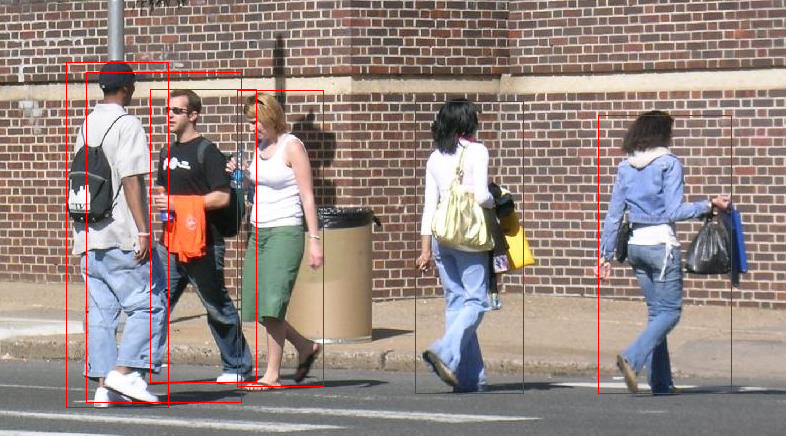

number of detected people: 2


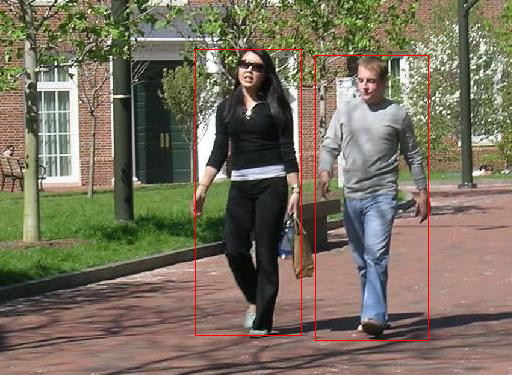

number of detected people: 2


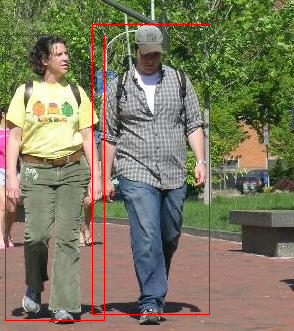

number of detected people: 6


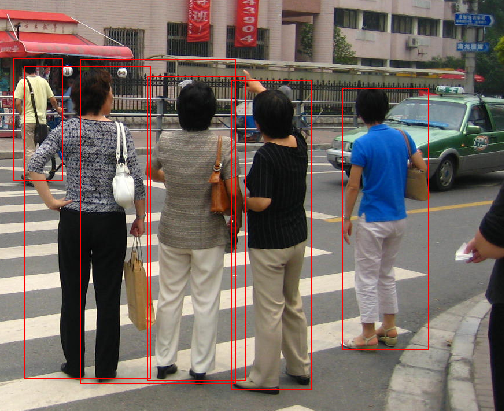

number of detected people: 3


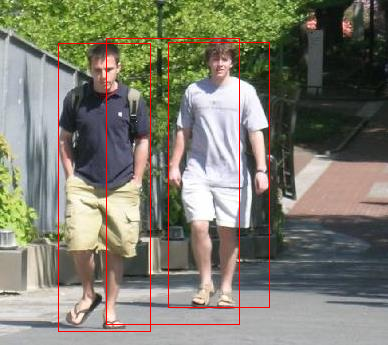

number of detected people: 6


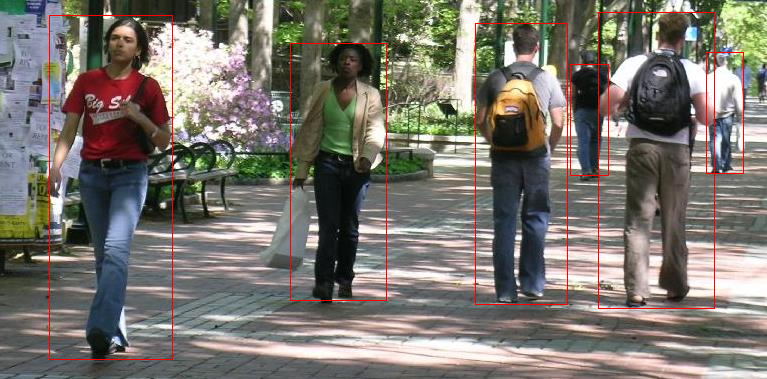

number of detected people: 5


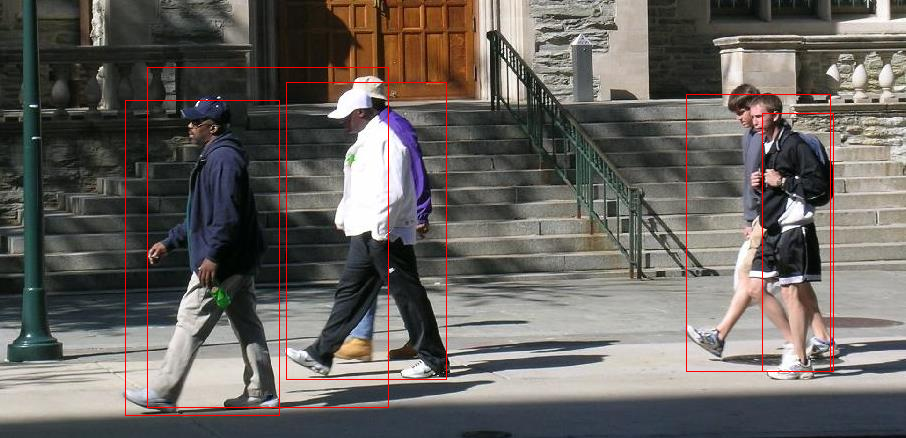

number of detected people: 3


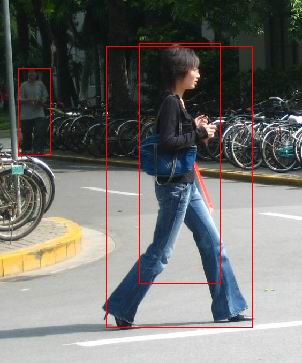

number of detected people: 14


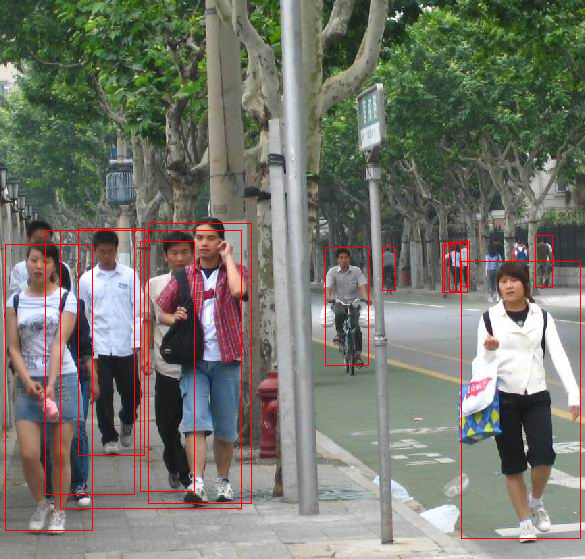

number of detected people: 1


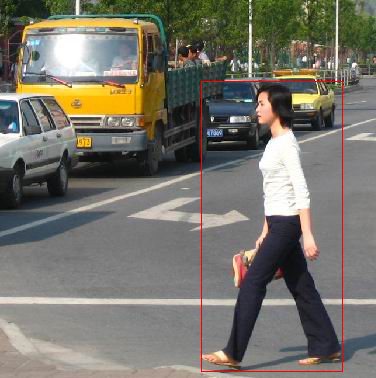

number of detected people: 1


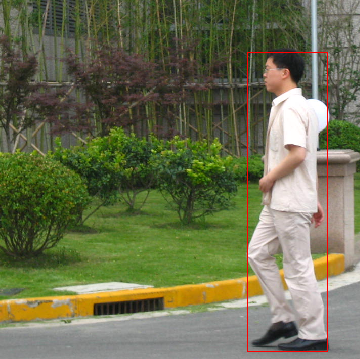

number of detected people: 3


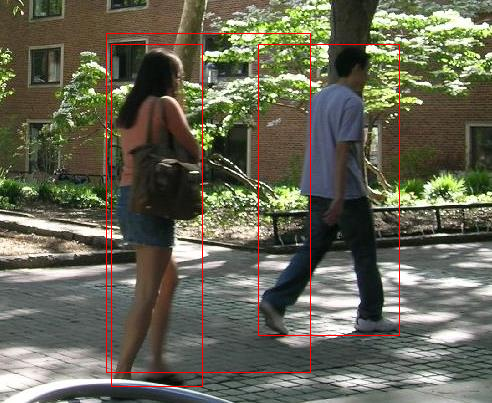

number of detected people: 4


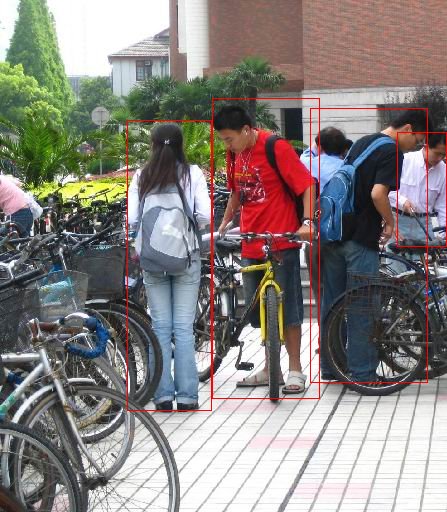

number of detected people: 5


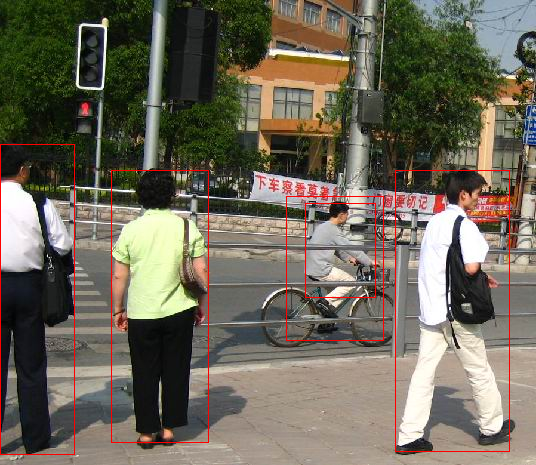

number of detected people: 9


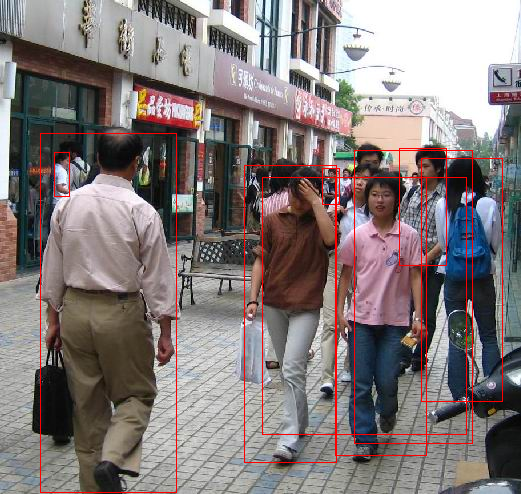

number of detected people: 1


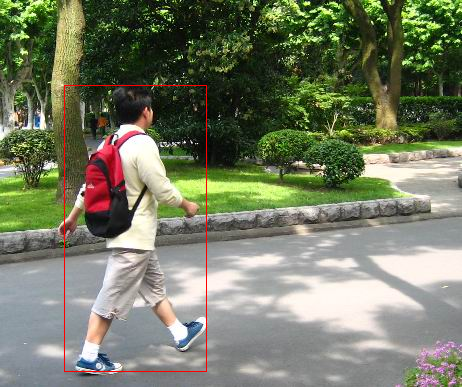

number of detected people: 3


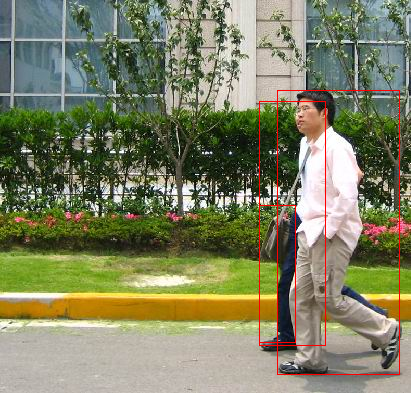

number of detected people: 3


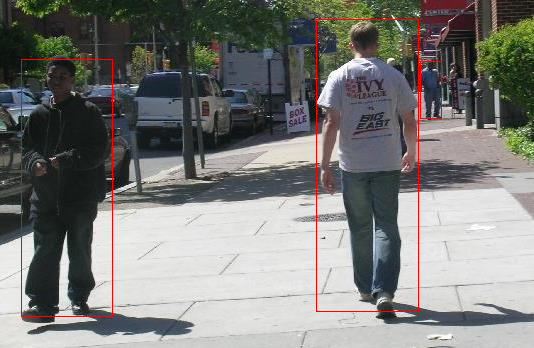

number of detected people: 12


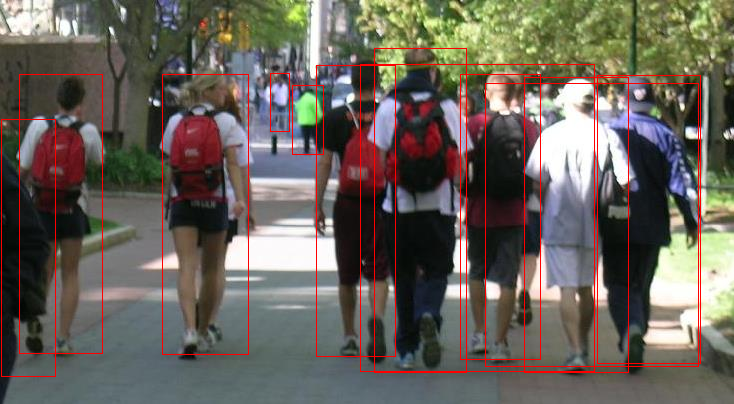

number of detected people: 4


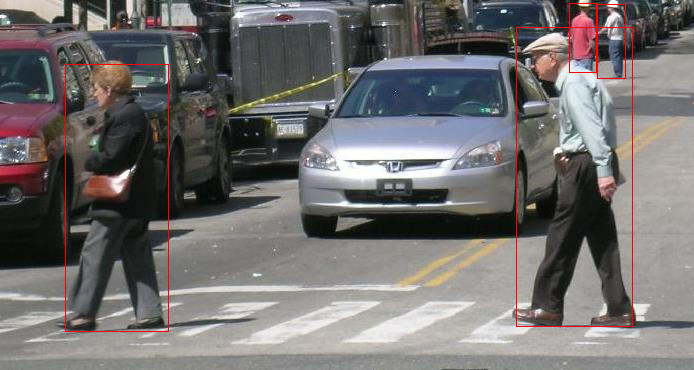

number of detected people: 3


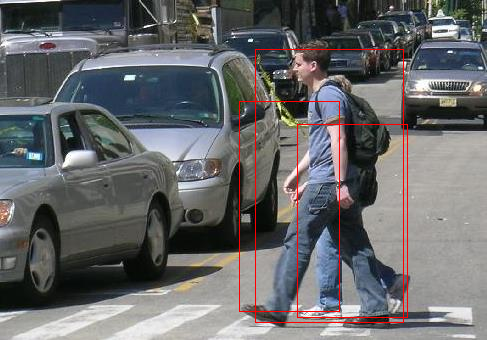

number of detected people: 1


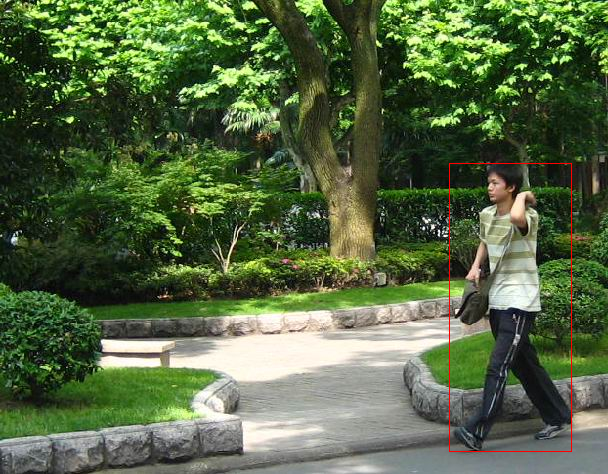

number of detected people: 1


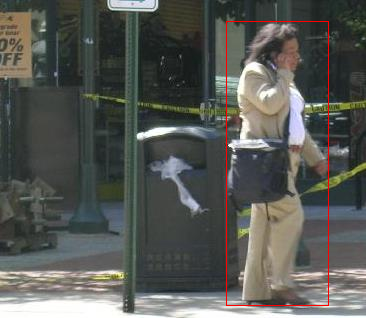

number of detected people: 3


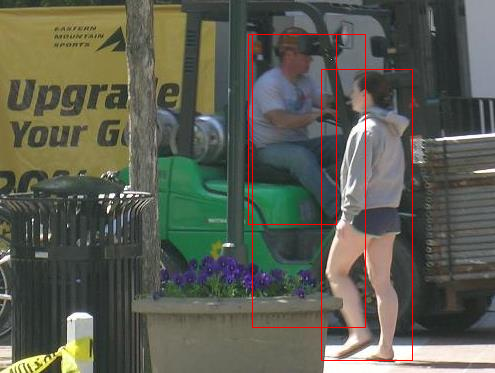

number of detected people: 3


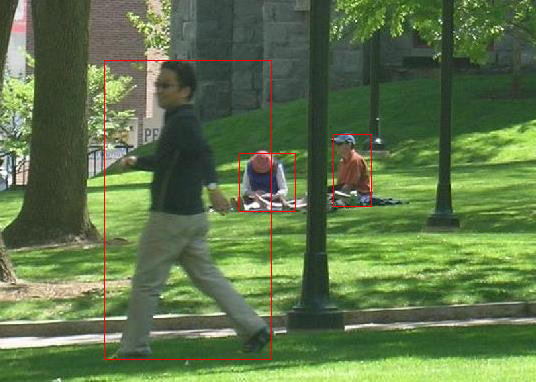

number of detected people: 2


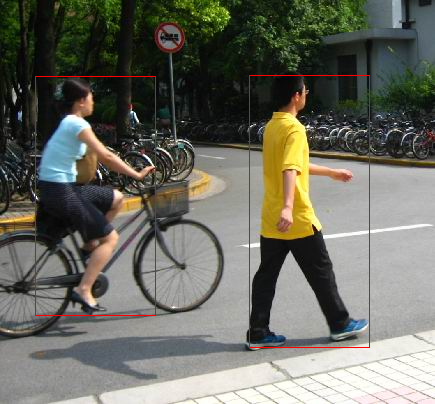

number of detected people: 2


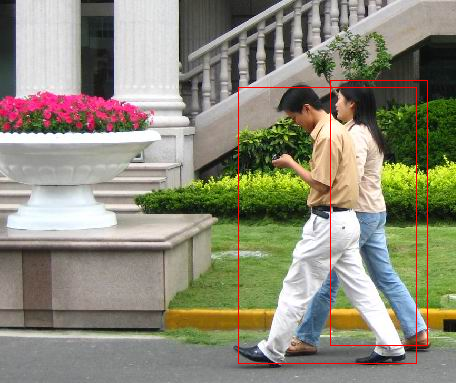

number of detected people: 13


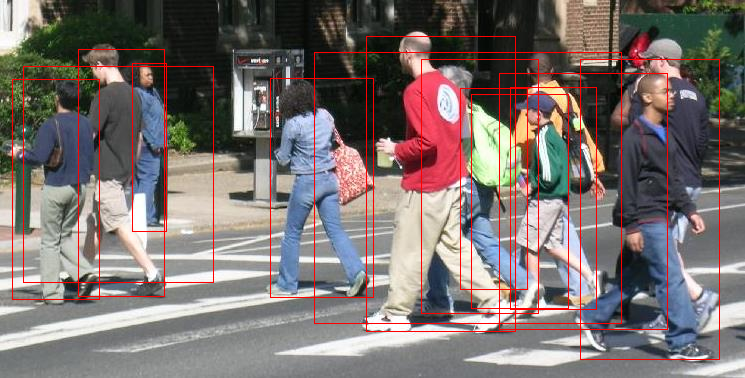

number of detected people: 1


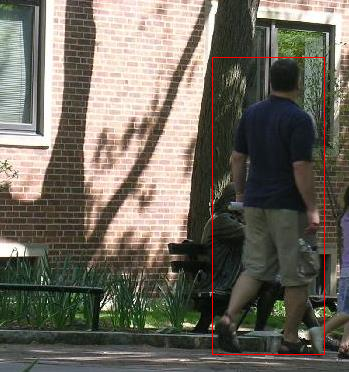

number of detected people: 1


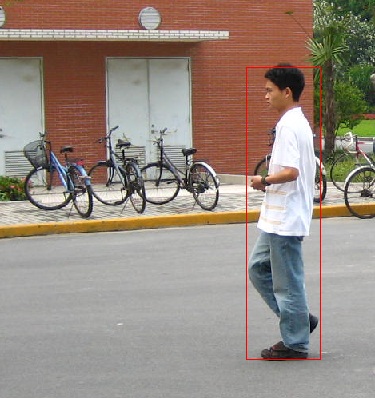

number of detected people: 7


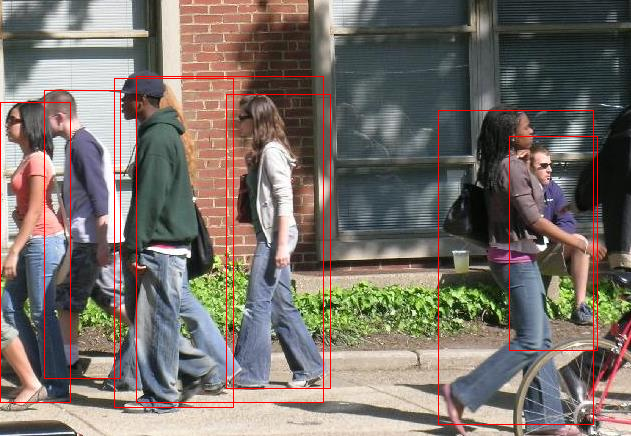

number of detected people: 6


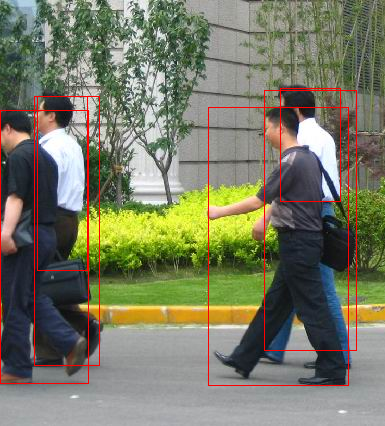

number of detected people: 7


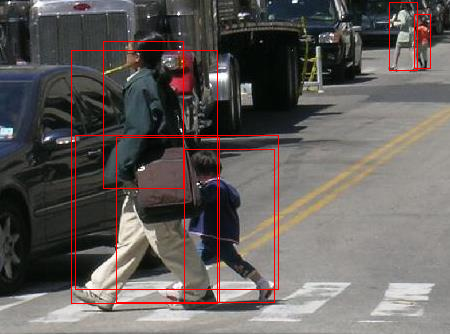

number of detected people: 2


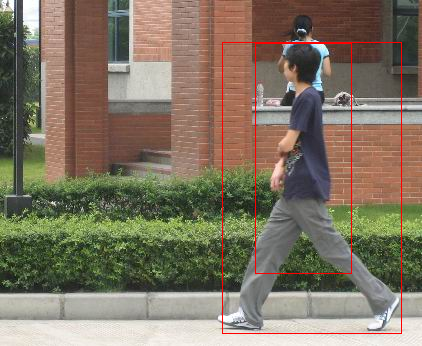

number of detected people: 6


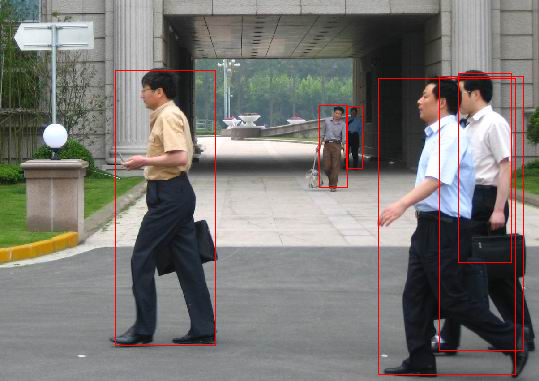

number of detected people: 1


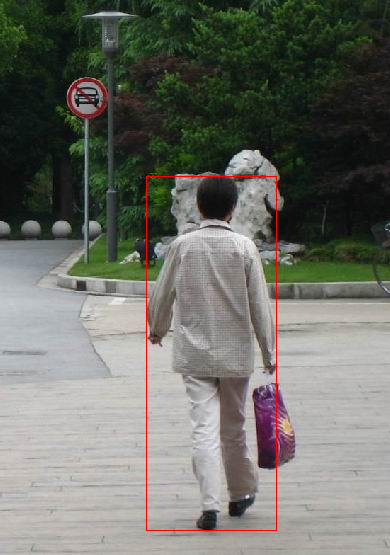

number of detected people: 5


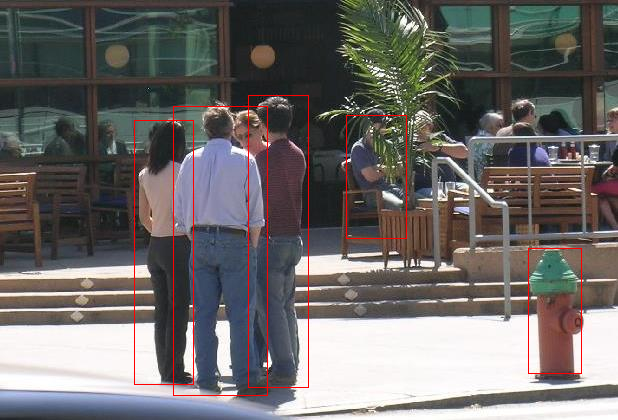

number of detected people: 2


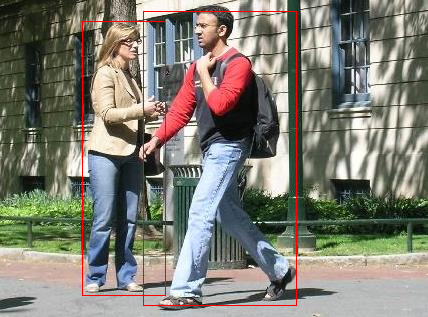

number of detected people: 4


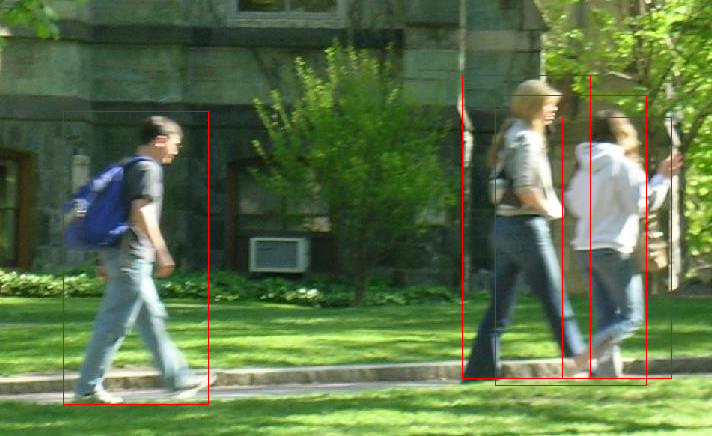

number of detected people: 1


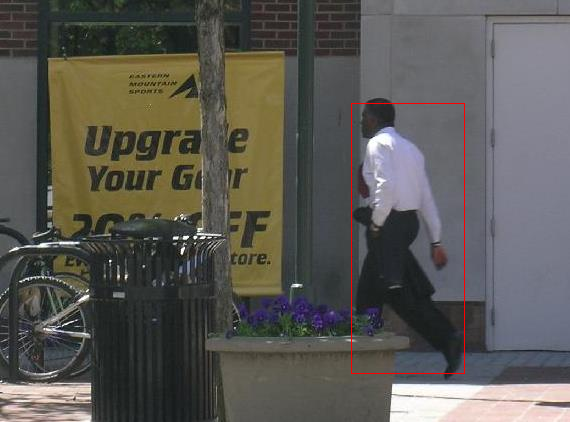

number of detected people: 4


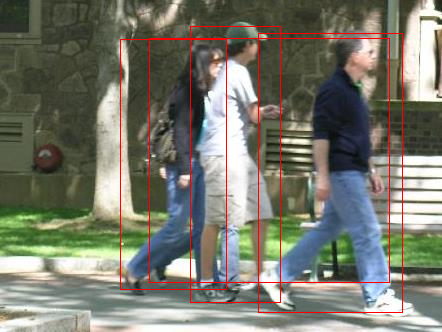

number of detected people: 2


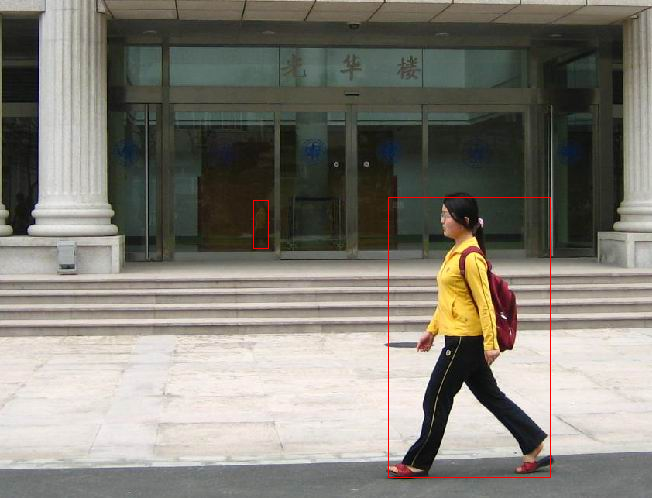

number of detected people: 1


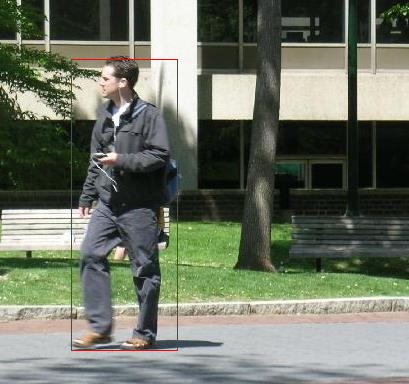

In [18]:
for i in range(len(dataset_test)):
    print('number of detected people: {}'.format(len(prediction[i][0]['boxes'])))
    bbox = []
    for j in range(len(prediction[i][0]['boxes'])):
        bbox.append(prediction[i][0]['boxes'].detach().cpu().numpy()[j])

    pred_img = Image.fromarray(basic[i].mul(255).permute(1, 2, 0).byte().numpy())
    draw = ImageDraw.Draw(pred_img)
    for k in range(len(prediction[i][0]['boxes'])):
        draw.rectangle(((bbox[k][0], bbox[k][1]), (bbox[k][2], bbox[k][3])), outline="red")

    display(pred_img)